# UTSA - CS 5243 - Computer Vision: Assignment-4

**Mao - Christopher - zbq615**


## Learning Objectives


*   Feature Detection
*   Feature Description
*   Feature Matching
*   Applications - Panorama, Tracking, Augmented Reality


In [ ]:
# Add your imports here
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Assume that the data files are in the following folder -- THIS WILL BE USED BY THE TA
basePath = "/content/drive/My Drive/Colab Notebooks/Computer Vision/Data/"

# Panorama Stitching (70 points)

Write code to create a panorama when provided with 2 images (left and right). You will be given 3 such image pairs and you need to create 3 panoramas.

Following is the rough algorithm of how to solve this problem:

*   Read the left and right images and plot them side by side
*   Detect and Draw Keypoints on the input images (use ORB)
*   Perform Feature Matching (use BFMatcher or FLANN)
*   Obtain the top matches (perform sorting or ratio test) and Update the keypoint lists based on the top matches found
*   Draw the maches across the two images
*   Find and Print the Homography matrix between the keypoints using RANSAC to transform image-2 in the perspective of image-1
*   Warp and Draw the image-2 in the perspective of image-1 -- the new image will have width equal to the sum of the individual widths of image-1 and image-2
*   Draw the final result image by pasting the original image-1 back on the above warped image-2


Perform the above steps on 3 image pairs. Following are the final results that are needed for each of the 3 image pairs

*   Original left and right RGB images
*   Features drawn on the original left and right RGB images
*   Feature matching image where lines are drawn between the left and right images
*   Warped image-2 in the perspective of image-1
*   Final panorama result


(EXTRA CREDITS - 10 points) Perform Blending on the seam (e.g., Feather, Laplacian, Multi-Band etc.)

In [ ]:
def pyramidBlending(A,B,mask,N):
  # Generate Gaussian pyramids for both images
  gaussian_pyramid_A = gaussian_pyramid(A,N)
  gaussian_pyramid_B = gaussian_pyramid(B,N)

  # Generate Laplacian pyramids for both images
  laplacian_pyramid_A = laplacian_pyramid(A,N)
  laplacian_pyramid_B = laplacian_pyramid(B,N)

  # Blend the Laplacian pyramids using the mask
  blended_pyramid = []
  for i in range(N):
    # cv2.resize(src = image, dsize = (width = cols, height = rows))
    resized_mask = cv2.resize(mask, (laplacian_pyramid_A[i].shape[1], laplacian_pyramid_A[i].shape[0]))
    sliced_level = np.zeros_like(laplacian_pyramid_A[i])

    for j in range(laplacian_pyramid_A[i].shape[0]):
      for k in range(laplacian_pyramid_A[i].shape[1]):
        for c in range(laplacian_pyramid_A[i].shape[2]):
          if resized_mask[j,k,c] == 0:
            sliced_level[j, k, c] = laplacian_pyramid_A[i][j, k, c]
          else:
            sliced_level[j, k, c] = laplacian_pyramid_B[i][j, k, c]
    blended_pyramid.append(sliced_level)

  # Reconstruct the blended image from the blended Laplacian pyramid
  blended_image = reconstruct_from_laplacian(blended_pyramid)
  return blended_image, gaussian_pyramid_A, gaussian_pyramid_B, laplacian_pyramid_A, laplacian_pyramid_B, blended_pyramid

def gaussian_pyramid(img, num_levels):
  pyramid = [img]
  for i in range(num_levels - 1):
    img = cv2.pyrDown(img)
    pyramid.append(img)
  return pyramid

def laplacian_pyramid(img, num_levels):
  pyramid = []
  for i in range(num_levels - 1):
    downsized = cv2.pyrDown(img) # Blur then downsample
    # 1. Convolve with Gaussian kernel, 2. Downsize by 1/2 in each dimension by removing every even-#'d row and col
    upsized = cv2.pyrUp(downsized) # Upsample then blur
    # 1. Upsize by 1/2 in each dimension and interpolate with 0's, 2. Convolve with Gaussian kernel (multiplied by 4) to approximate values of missing pixels
    #upsized = cv2.resize(upsized, (img.shape[1], img.shape[0]))
    laplacian = img - upsized
    pyramid.append(laplacian)
    img = downsized
  pyramid.append(img)
  return pyramid

def reconstruct_from_laplacian(pyramid):
  reconstructed_images = []
  reconstructed_images.append(pyramid[-1])
  reconstructed_image = pyramid[-1]
  for i in range(len(pyramid)-2, -1, -1):
    reconstructed_image = cv2.pyrUp(reconstructed_image)
    reconstructed_image = reconstructed_image + pyramid[i]
    reconstructed_images.append(reconstructed_image)
  reconstructed_images.reverse()
  return reconstructed_images

In [ ]:
def panorama(left_image, right_image):
  # 1. Read the left and right images and plot side by side
  plt.figure(figsize=(15, 10))
  plt.subplot(1, 2, 1)
  plt.imshow(left_image)
  plt.title("Left Image")
  plt.subplot(1, 2, 2)
  plt.imshow(right_image)
  plt.title("Right Image")
  plt.show()

  # 2. Detect ORB features and draw keypoints
  orb = cv2.ORB_create()
  kp1, des1 = orb.detectAndCompute(left_image, None)
  kp2, des2 = orb.detectAndCompute(right_image, None)
  left_image_kp = cv2.drawKeypoints(left_image, kp1, None, color=(0, 255, 0), flags=0)
  right_image_kp = cv2.drawKeypoints(right_image, kp2, None, color=(0, 255, 0), flags=0)
  plt.figure(figsize=(15, 10))
  plt.subplot(1, 2, 1)
  plt.imshow(left_image_kp)
  plt.title("Left Image with Keypoints")
  plt.subplot(1, 2, 2)
  plt.imshow(right_image_kp)
  plt.title("Right Image with Keypoints")
  plt.show()

  # 3. Perform feature matching
  bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
  matches = bf.match(des1, des2)

  # 4. Obtain the top matches to update the keypoint lists
  matches = sorted(matches, key = lambda x:x.distance)
  num_matches_to_keep = 50
  matches = matches[:num_matches_to_keep]
  kp1_top = [kp1[m.queryIdx] for m in matches]
  kp2_top = [kp2[m.trainIdx] for m in matches]

  # 5. Draw the matches across left and right images
  matched_img = cv2.drawMatches(left_image, kp1, right_image, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  plt.figure(figsize=(15, 10))
  plt.imshow(matched_img)
  plt.title("Feature Matching")
  plt.show()

  # 6. Print homography matrix between keypoints using RANSAC to transform right image in perspective of left image
  src_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
  dst_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
  M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
  print("Homography Matrix:")
  print(M)

  # 7. Warp and draw right image in perspective of left image
  rows1, cols1 = left_image.shape[:2]
  rows2, cols2 = right_image.shape[:2]
  output_width = cols1 + cols2
  output_height = max(rows1, rows2)
  warped_image = cv2.warpPerspective(right_image, M, (output_width, output_height))
  plt.figure(figsize=(15, 10))
  plt.imshow(warped_image)
  plt.title("Warped Right Image")
  plt.show()

  # 8. Draw final panorama by pasting original left image above warped right image
  result_image = warped_image.copy()
  result_image[0:rows1, 0:cols1] = left_image
  plt.figure(figsize=(15, 10))
  plt.imshow(result_image)
  plt.title("Final Panorama")
  plt.show()

  # 9. Extra credit - Blend on the seam
  image_A = np.zeros((output_height, output_width, 3), dtype=np.uint8)
  image_A[0:rows1, 0:cols1] = left_image
  image_B = warped_image.copy()
  mask = np.zeros((image_A.shape[0], image_A.shape[1], 3), dtype=np.uint8)
  mask[:, cols1:, :] = 255
  image_A = cv2.resize(image_A, (4096, 1024))
  image_B = cv2.resize(image_B, (4096, 1024))
  mask = cv2.resize(mask, (4096, 1024))
  blended_image, gaussian_pyramid_A, gaussian_pyramid_B, laplacian_pyramid_A, laplacian_pyramid_B, blended_pyramid = pyramidBlending(image_A, image_B, mask, 5)
  plt.figure(figsize=(15, 10))
  plt.imshow(blended_image[0])
  plt.title("Blended Image")
  plt.show()

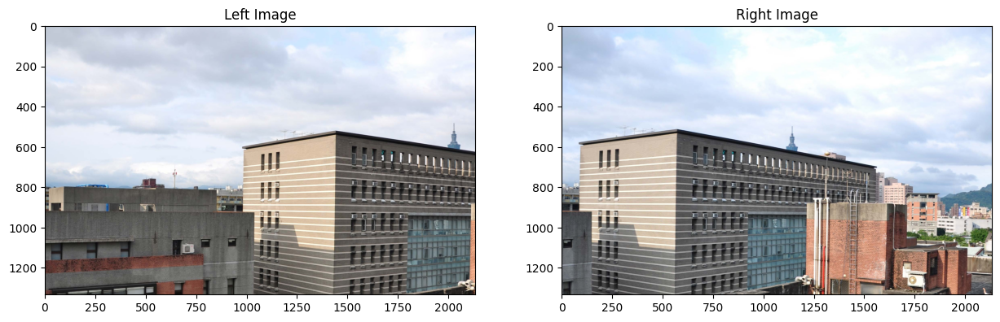

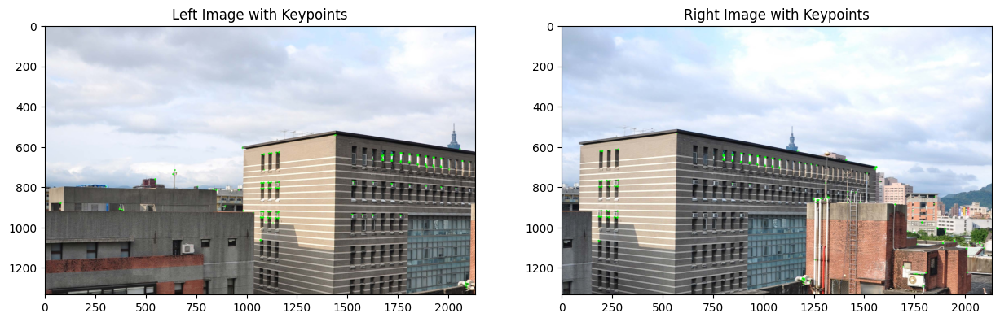

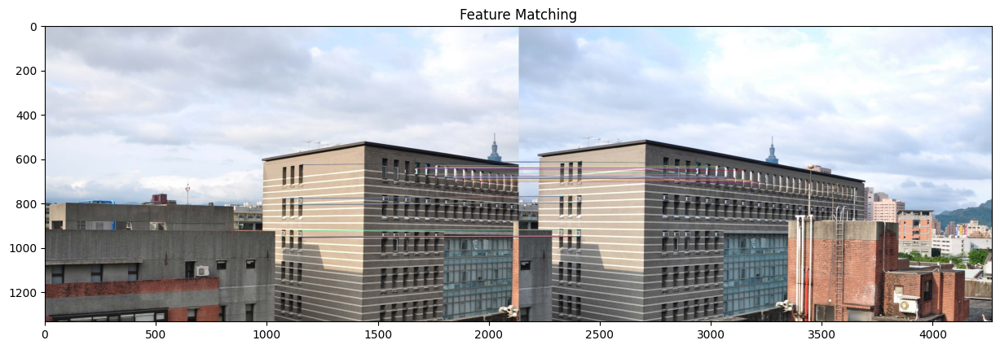

Homography Matrix:
[[ 8.46884682e-01  6.70927163e-03  8.96747621e+02]
 [-6.89663913e-02  9.54129651e-01  5.05612305e+01]
 [-7.14368213e-05  3.90762850e-06  1.00000000e+00]]


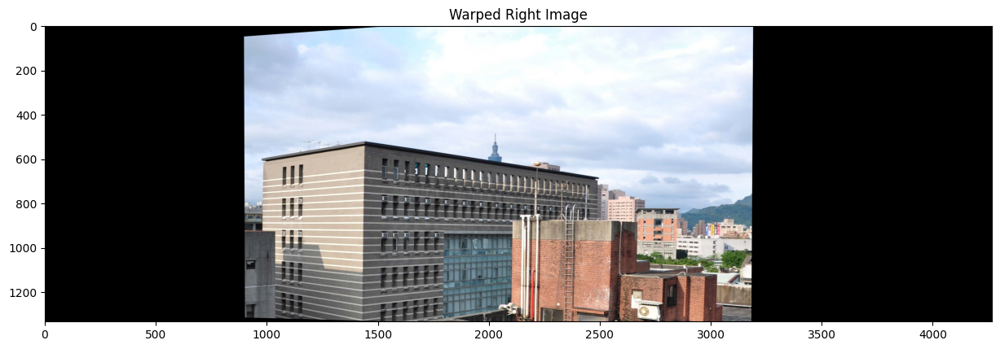

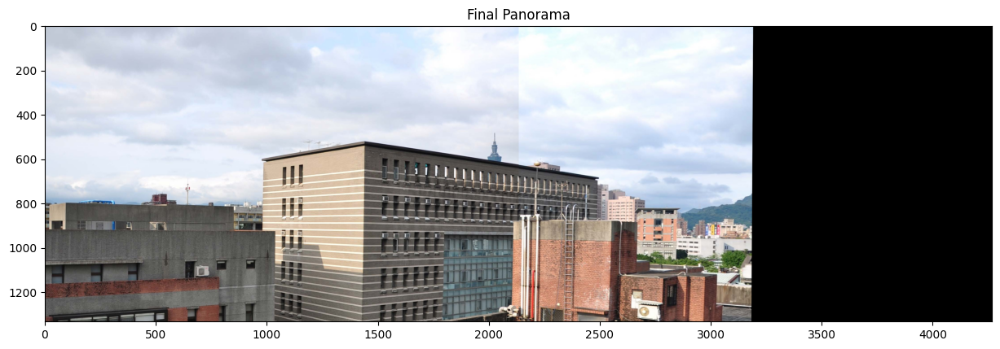

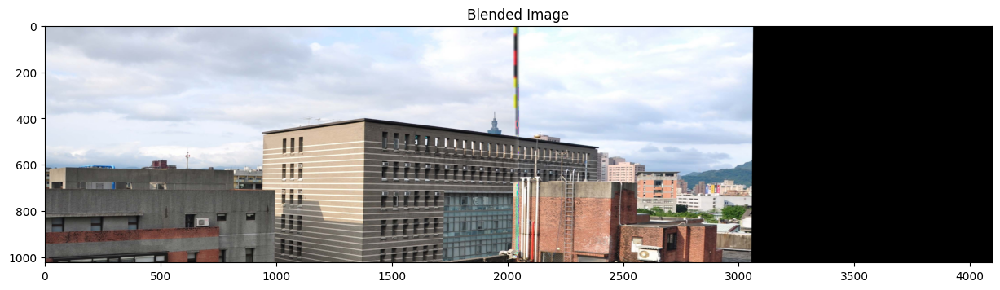

In [ ]:
img1 = cv2.cvtColor(cv2.imread(basePath+"panorama-1-a.jpg"), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread(basePath+"panorama-1-b.jpg"), cv2.COLOR_BGR2RGB)
panorama(img1, img2)

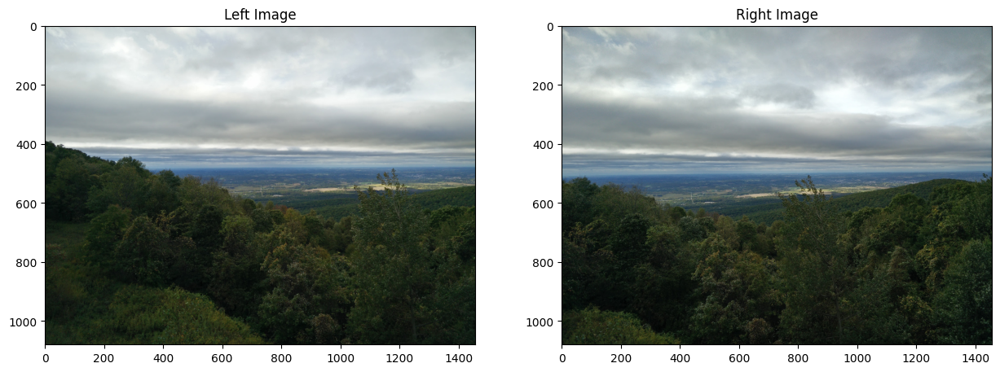

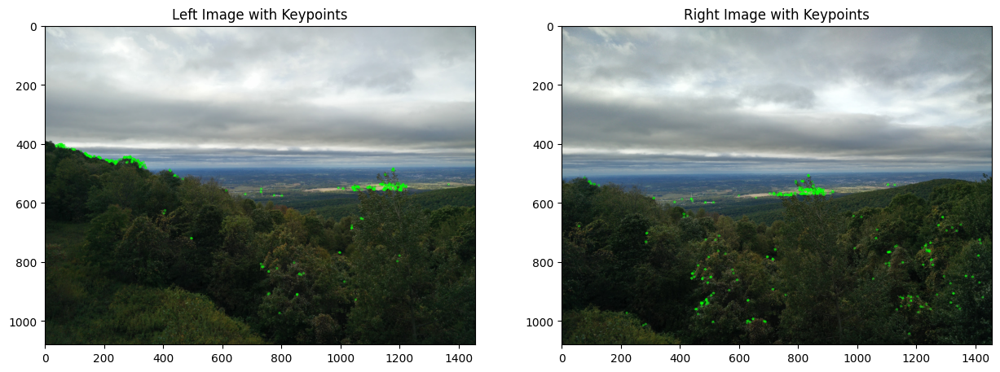

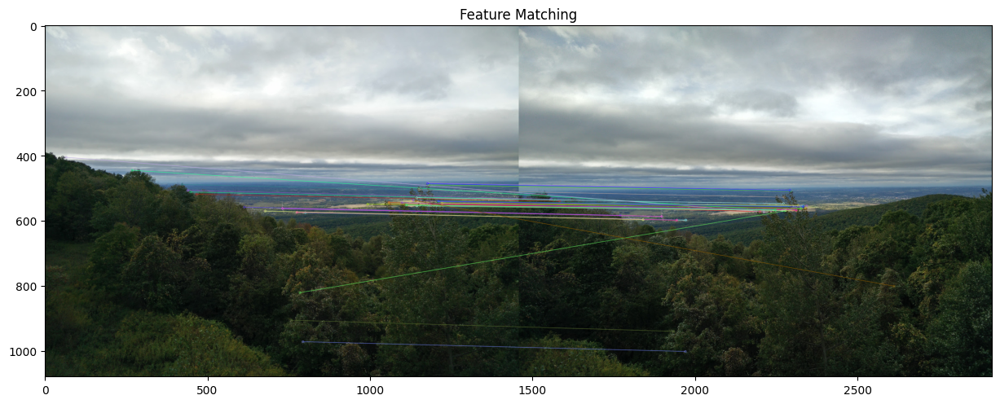

Homography Matrix:
[[ 7.20489753e-01 -1.33158869e-01  4.40564626e+02]
 [-1.16064359e-01  9.27225394e-01  2.82263537e+01]
 [-2.42980578e-04  5.83715006e-05  1.00000000e+00]]


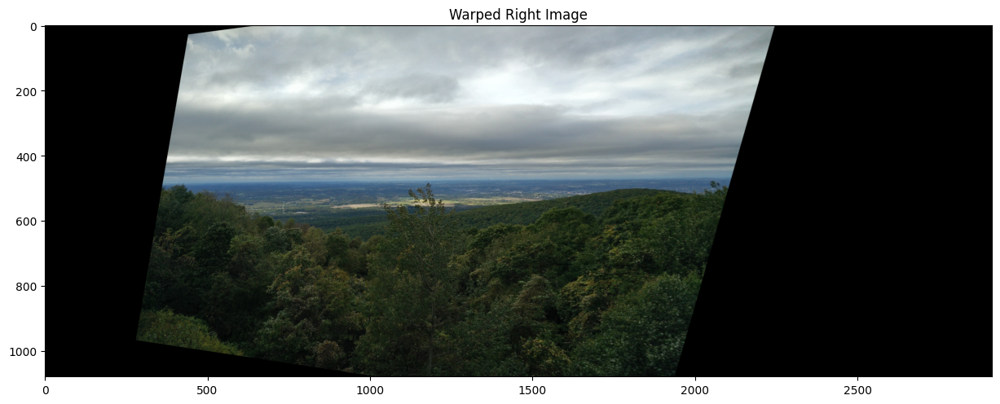

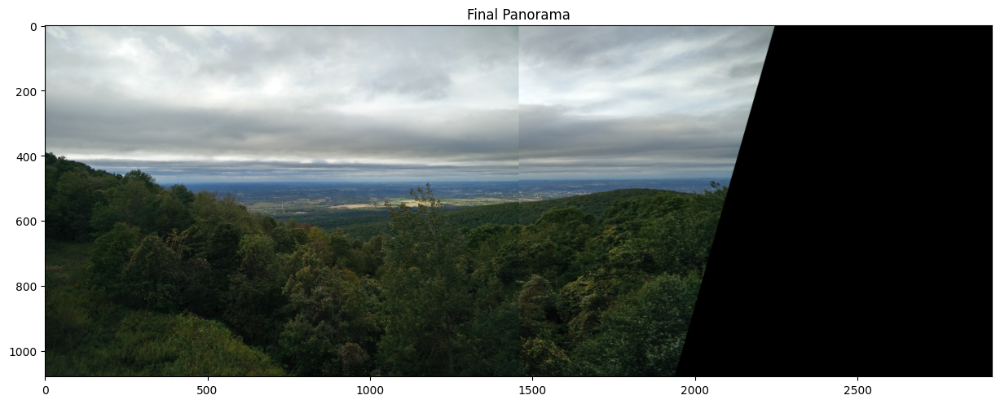

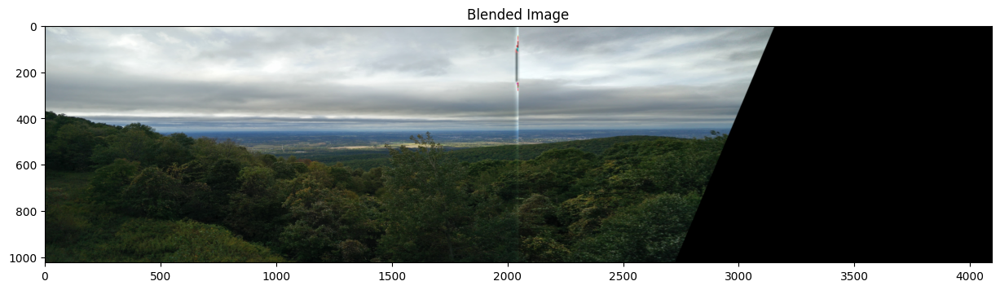

In [ ]:
img1 = cv2.cvtColor(cv2.imread(basePath+"panorama-2-a.jpg"), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread(basePath+"panorama-2-b.jpg"), cv2.COLOR_BGR2RGB)
panorama(img1, img2)

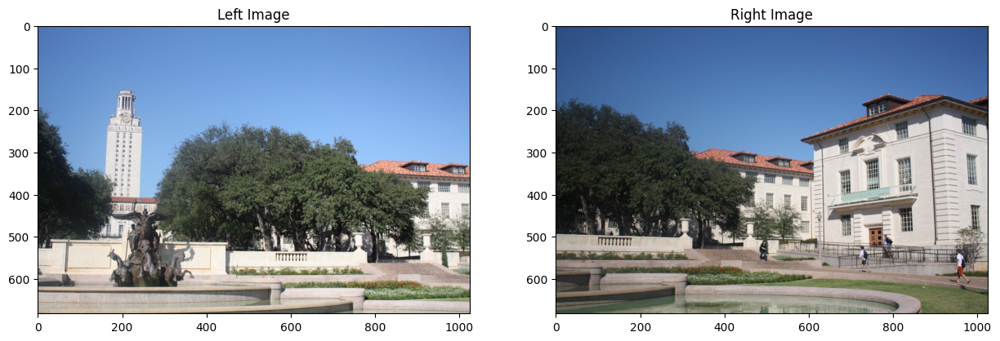

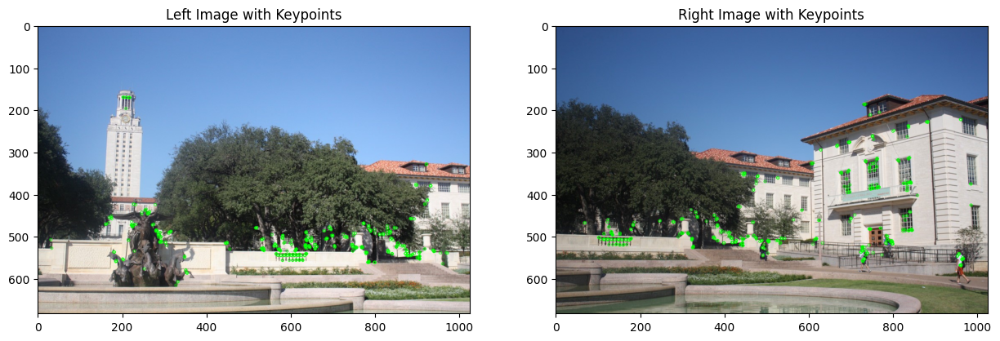

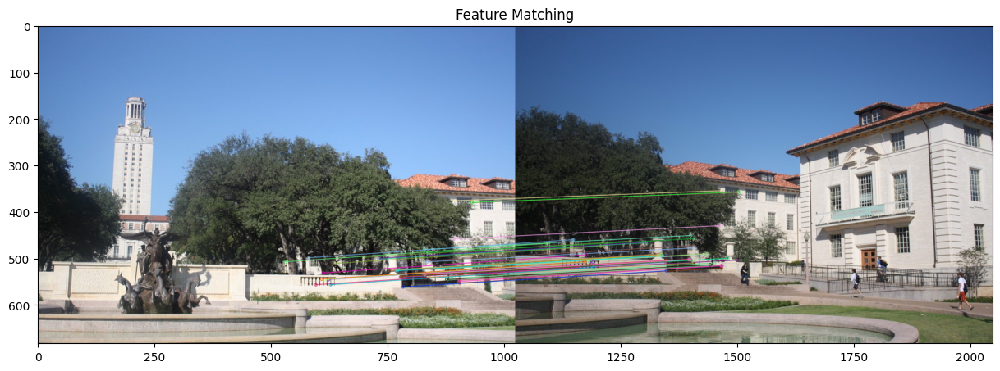

Homography Matrix:
[[ 7.97537701e-01  8.95156882e-02  4.31202385e+02]
 [-1.31501042e-01  9.68241867e-01  6.13681913e+01]
 [-2.04634013e-04  1.78445529e-05  1.00000000e+00]]


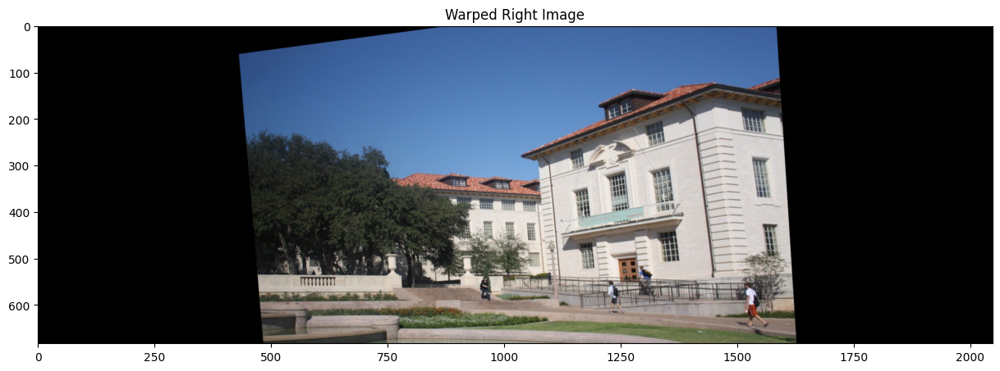

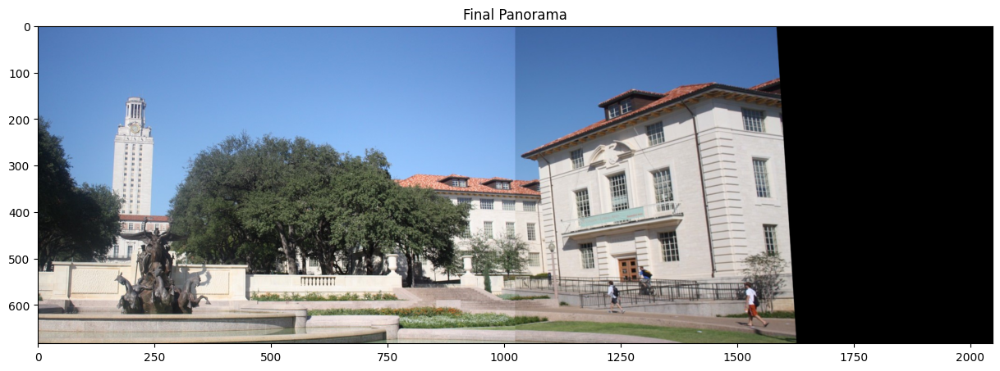

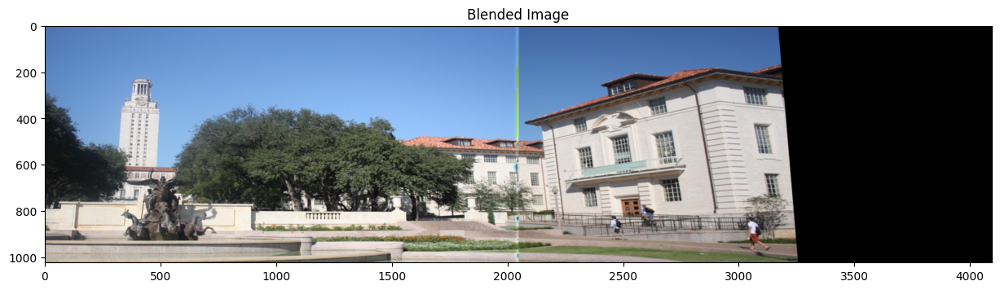

In [ ]:
img1 = cv2.cvtColor(cv2.imread(basePath+"panorama-3-a.jpg"), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread(basePath+"panorama-3-b.jpg"), cv2.COLOR_BGR2RGB)
panorama(img1, img2)

# Detect & Track object (30 points)

Find a "template" object in the video which can vary in position, rotation, and scale. Draw a bounding box around the object and keep on tracking that object.

Following is the rough algorithm of how to solve this problem:

*   Use the above functions / code to Detect Features on the "template" image that is supposed to be tracked
*   Read the input video frame by frame
    - Detect and compute features for the image frame
    - Find the feature matches between the features of the video image frame and that of the "template" image (perform sorting or ratio test, if needed)
    - Update the keypoint lists to align them based on matches found
    - Find the homography matrix between the keypoints to transform the "template" image in the perspective of the video image frame
    - Create a copy of the video image frame
    - Take a vector of the 4 corners of the "template" image
    - Do a perspective transform of the vector to get the rectangle corner in the video image frame
    - Draw borders / lines using the 4 transformed corners to get the new video image frame
    - Write this new image frame to the output video writer
*   Play the output video on Colab

In [ ]:
from IPython.display import HTML
from base64 import b64encode

# https://stackoverflow.com/questions/57377185/how-play-mp4-video-in-google-colab
def show_video(video_path):
  """
  Plays a video file in Colab.

  Args:
    video_path: Path to the video file.
  """
  mp4 = open(video_path,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML("""
  <video controls>
      <source src="%s" type="video/mp4">
  </video>
  """ % data_url)

In [ ]:
from moviepy.editor import *

def detect_and_track_object(video_path, template_path, output_path):
  template_img = cv2.imread(template_path, cv2.IMREAD_GRAYSCALE)

  orb = cv2.ORB_create()

  kp_template, des_template = orb.detectAndCompute(template_img, None)

  cap = cv2.VideoCapture(video_path)

  frame_width = int(cap.get(3))
  frame_height = int(cap.get(4))
  fps = cap.get(cv2.CAP_PROP_FPS)

  temp_path = output_path.replace(".mp4", "_temp.mp4")

  out = cv2.VideoWriter(temp_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

  while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
      break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    kp_frame, des_frame = orb.detectAndCompute(gray_frame, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des_template, des_frame)
    matches = sorted(matches, key=lambda x: x.distance)

    min_matches = 10
    if len(matches) > min_matches:
      src_pts = np.float32([kp_template[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
      dst_pts = np.float32([kp_frame[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

      M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

      if M is not None:
        h, w = template_img.shape

        pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)

        dst = cv2.perspectiveTransform(pts, M)

        cv2.polylines(frame, [np.int32(dst)], True, (0, 255, 0), 2)

    out.write(frame)

  cap.release()
  out.release()
  cv2.destroyAllWindows()

  audio = AudioFileClip(video_path)
  video = VideoFileClip(temp_path).without_audio()
  combine = video.set_audio(audio)
  combine.write_videofile(output_path)

video_path = basePath + 'book.mp4'
template_path = basePath + 'cv_cover.jpg'
output_path = basePath + 'output_video.mp4'

detect_and_track_object(video_path, template_path, output_path)
show_video(output_path)

Moviepy - Building video /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video.mp4.
MoviePy - Writing audio in output_videoTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video.mp4



t: 100%|█████████▉| 639/642 [00:18<00:00, 39.55it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_temp.mp4, 921600 bytes wanted but 0 bytes read,at frame 641/642, at time 21.37/21.37 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video.mp4


# Replace object in video with new object "image" (10 points)

Find a "template" object in the video which can vary in position, rotation, and scale. Replace that object throughout the video with a new "replacement" object, which can be different in shape than the original "template" image.

The rough algorithm of how to solve this problem is the same as above with only some changes:

*   Use the above functions / code to Detect Features on the "template" image that is supposed to be tracked
*   Read the "replacement" image that is supposed to be in the resultant video
*   Resize the "replacement" image to match the shape of the "template" image
*   Read the input video frame by frame
    - Detect and compute features for the image frame
    - Find the feature matches between the features of the video image frame and that of the "template" image (perform sorting or ratio test, if needed)
    - Update the keypoint lists to align them based on matches found
    - Find the homography matrix between the keypoints to transform the "template" image in the perspective of the video image frame
    - Create a copy of the video image frame
    - Use the homography matrix to warp the "replacement" image in the perspective of the video image frame
    - Copy the "transformed replacement" image on to the video image frame copy
    - Write this new image frame to the output video writer
*   Play the output video on Colab

In [ ]:
def replace_object_in_video(video_path, template_path, replacement_path, output_path):
  template_img = cv2.imread(template_path, cv2.IMREAD_GRAYSCALE)
  replacement_img = cv2.imread(replacement_path)

  rows1, cols1 = template_img.shape[:2]
  rows2, cols2 = replacement_img.shape[:2]
  replacement_img = cv2.resize(replacement_img, (cols1, rows1))

  orb = cv2.ORB_create()

  kp_template, des_template = orb.detectAndCompute(template_img, None)

  cap = cv2.VideoCapture(video_path)

  frame_width = int(cap.get(3))
  frame_height = int(cap.get(4))
  fps = cap.get(cv2.CAP_PROP_FPS)

  temp_path = output_path.replace(".mp4", "_temp.mp4")

  out = cv2.VideoWriter(temp_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

  while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
      break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    kp_frame, des_frame = orb.detectAndCompute(gray_frame, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des_template, des_frame)
    matches = sorted(matches, key=lambda x: x.distance)

    min_matches = 10
    if len(matches) > min_matches:
      src_pts = np.float32([kp_template[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
      dst_pts = np.float32([kp_frame[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

      M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

      if M is not None:
        h, w = template_img.shape
        replacement_img_warped = cv2.warpPerspective(replacement_img, M, (frame.shape[1], frame.shape[0]))

        mask = np.zeros((frame.shape[0], frame.shape[1]), dtype=np.uint8)
        pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(pts, M)
        cv2.fillPoly(mask, [np.int32(dst)], (255, 255, 255))

        polygon_coords = np.where(mask)
        frame[polygon_coords[0], polygon_coords[1]] = replacement_img_warped[polygon_coords[0], polygon_coords[1]]

      out.write(frame)

  cap.release()
  out.release()
  cv2.destroyAllWindows()

  audio = AudioFileClip(video_path)
  video = VideoFileClip(temp_path).without_audio()
  combine = video.set_audio(audio)
  combine.write_videofile(output_path)

video_path = basePath + 'book.mp4'
template_path = basePath + 'cv_cover.jpg'
replacement_path = basePath + 'hp_cover.jpg'
output_path = basePath + 'output_video_replaced.mp4'

replace_object_in_video(video_path, template_path, replacement_path, output_path)
show_video(output_path)

Moviepy - Building video /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced.mp4.
MoviePy - Writing audio in output_video_replacedTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced.mp4



t: 100%|█████████▉| 640/642 [00:19<00:00, 39.54it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced_temp.mp4, 921600 bytes wanted but 0 bytes read,at frame 641/642, at time 21.37/21.37 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced.mp4


# Replace object in video with new object "video" (15 points)

Find a "template" object in the video which can vary in position, rotation, and scale. Replace that object throughout the video with a new "replacement-video", which can be different in shape than the original "template" image.

The rough algorithm of how to solve this problem is the same as above with only some changes:

*   Use the above functions / code to Detect Features on the "template" image that is supposed to be tracked
*   Read the "replacement" image that is supposed to be in the resultant video
*   Resize the "replacement" image to match the shape of the "template" image
*   Read both the input videos in parallel frame by frame
    - Detect and compute features for the image frame
    - Find the feature matches between the features of the video image frame and that of the "template" image (perform sorting or ratio test, if needed)
    - Update the keypoint lists to align them based on matches found
    - Find the homography matrix between the keypoints to transform the "template" image in the perspective of the video image frame
    - Create a copy of the original video image frame
    - Extract the center portion of the "replacement video". The height should remain the same, but you need to crop the corresponding columns from the center so that the aspect ratio matches that of the "template" image
    - Resize the "extracted replacement video" image frame to match the size of the "template" image
    - Use the homography matrix to warp the "resized extracted replacement video" image in the perspective of the video image frame
    - Copy the "transformed replacement video" image on to the original video image frame copy
    - Write this new image frame to the output video writer
*   Play the output video on Colab

In [ ]:
def replace_object_in_video_with_video(video_path, template_path, replacement_video_path, output_path):
  template_img = cv2.imread(template_path, cv2.IMREAD_GRAYSCALE)
  orb = cv2.ORB_create()
  kp_template, des_template = orb.detectAndCompute(template_img, None)
  cap_main = cv2.VideoCapture(video_path)
  cap_replacement = cv2.VideoCapture(replacement_video_path)
  frame_width = int(cap_main.get(3))
  frame_height = int(cap_main.get(4))
  fps = cap_replacement.get(cv2.CAP_PROP_FPS)
  temp_path = output_path.replace(".mp4", "_temp.mp4")
  out = cv2.VideoWriter(temp_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))
  while cap_main.isOpened() and cap_replacement.isOpened():
    ret_main, frame_main = cap_main.read()
    ret_replacement, frame_replacement = cap_replacement.read()
    if not ret_main or not ret_replacement:
      break
    gray_frame = cv2.cvtColor(frame_main, cv2.COLOR_BGR2GRAY)
    kp_frame, des_frame = orb.detectAndCompute(gray_frame, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des_template, des_frame)
    matches = sorted(matches, key=lambda x: x.distance)
    min_matches = 10
    if len(matches) > min_matches:
      src_pts = np.float32([kp_template[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
      dst_pts = np.float32([kp_frame[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
      M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
      if M is not None:
        h_template, w_template = template_img.shape
        h_replacement, w_replacement = frame_replacement.shape[:2]
        new_h_replacement = h_template
        new_w_replacement = int(new_h_replacement * (w_template / h_template))
        frame_replacement_resized = cv2.resize(frame_replacement, (new_w_replacement, new_h_replacement))
        center = frame_replacement_resized.shape[1]//2
        frame_replacement_cropped = frame_replacement_resized[:, center-w_template//2:center+w_template//2]
        frame_replacement_warped = cv2.warpPerspective(frame_replacement_resized, M, (frame_main.shape[1], frame_main.shape[0]))
        mask = np.zeros((frame_main.shape[0], frame_main.shape[1]), dtype=np.uint8)
        pts = np.float32([[0, 0], [0, h_template - 1], [w_template - 1, h_template - 1], [w_template - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(pts, M)
        cv2.fillPoly(mask, [np.int32(dst)], (255, 255, 255))
        polygon_coords = np.where(mask)
        frame_main[polygon_coords[0], polygon_coords[1]] = frame_replacement_warped[polygon_coords[0], polygon_coords[1]]
    out.write(frame_main)
  cap_main.release()
  cap_replacement.release()
  out.release()
  cv2.destroyAllWindows()
  audio = AudioFileClip(replacement_video_path)
  video = VideoFileClip(temp_path).without_audio()
  combine = video.set_audio(audio)
  combine.write_videofile(output_path)

video_path = basePath + 'book.mp4'
template_path = basePath + 'cv_cover.jpg'
replacement_video_path = basePath + 'ar_source.mp4'
output_path = basePath + 'output_video_replaced_video.mp4'

replace_object_in_video_with_video(video_path, template_path, replacement_video_path, output_path)
show_video(output_path)

Moviepy - Building video /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced_video.mp4.
MoviePy - Writing audio in output_video_replaced_videoTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced_video.mp4



Moviepy - Done !
Moviepy - video ready /content/drive/My Drive/Colab Notebooks/Computer Vision/Data/output_video_replaced_video.mp4


#Submission Instructions



1.   Complete all tasks above
2.   Export this notebook as .ipynb
      (File > Download > Download .ipynb)
3.   Upload the completed .ipynb file + output videos on Canvas


##Rubric

*   (70 points) Panorama Stitching
    * (extra credit - 10 points) Blending
*   (30 points) Detect & Track object
*   (10 points) Replace object in video with new object "image"
*   (15 points) Replace object in video with new object "video"